<a href="https://colab.research.google.com/github/JeMinYoo/Aiffel-Quest/blob/master/QuestC/Flower/Flower.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. VGG16 모델

In [ ]:
import tensorflow_datasets as tfds
# 데이터셋 다운로드 및 로드
(raw_train, raw_validation, raw_test), metadata = tfds.load(
    name='tf_flowers',
    split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
    data_dir='/content/drive/MyDrive/Flowers',  # Google Drive에 저장
    #download=True,  # 데이터셋 다운로드
    with_info=True,
    as_supervised=True,
)

print("Datasets 성공적으로 다운로드")

Dl Completed...:   0%|          | 0/5 [00:00<?, ? file/s]

Dataset tf_flowers downloaded and prepared to /content/drive/MyDrive/Flowers/tf_flowers/3.0.1. Subsequent calls will reuse this data.
Datasets 성공적으로 다운로드


In [ ]:
from google.colab import drive
# Google Drive 마운트
drive.mount('/content/drive')

ValueError: Mountpoint must not already contain files

In [ ]:
# DatasetInfo 객체에서 정보 추출
info = metadata
class_names = info.features['label'].names
num_classes = len(class_names)
print("레이블 종류:", class_names)

레이블 종류: ['dandelion', 'daisy', 'tulips', 'sunflowers', 'roses']


In [ ]:
print(raw_train)
print(raw_validation)
print(raw_test)

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

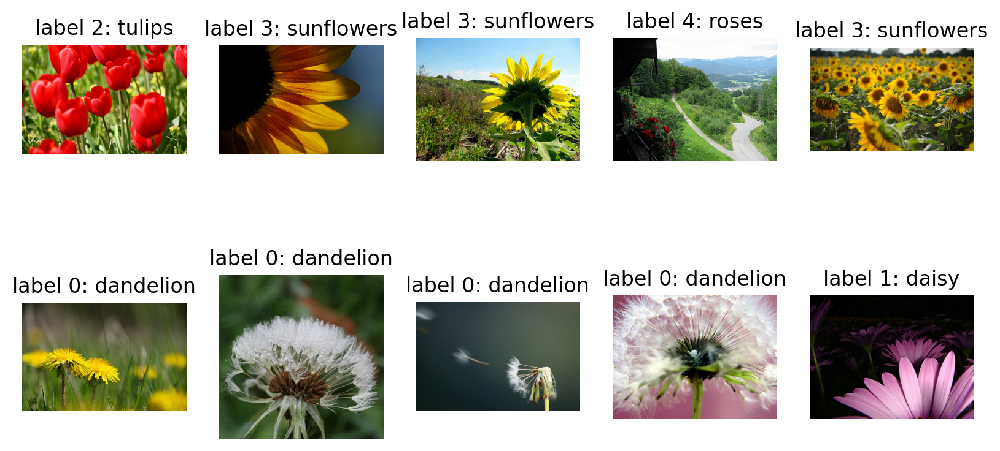

In [ ]:
plt.figure(figsize=(10, 5))

get_label_name = metadata.features['label'].int2str

for idx, (image, label) in enumerate(raw_train.take(10)):  # 10개의 데이터를 가져 옵니다.
    plt.subplot(2, 5, idx+1)
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

In [ ]:
IMG_SIZE = 299 # 리사이징할 이미지의 크기

def format_example(image, label):
    image = tf.cast(image, tf.float32)  # image=float(image)같은 타입캐스팅의  텐서플로우 버전입니다.
    image = (image/127.5) - 1 # 픽셀값의 scale 수정
    image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))
    return image, label

In [ ]:
train = raw_train.map(format_example)
validation = raw_validation.map(format_example)
test = raw_test.map(format_example)

print(train)
print(validation)
print(test)

<_MapDataset element_spec=(TensorSpec(shape=(299, 299, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(299, 299, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(299, 299, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


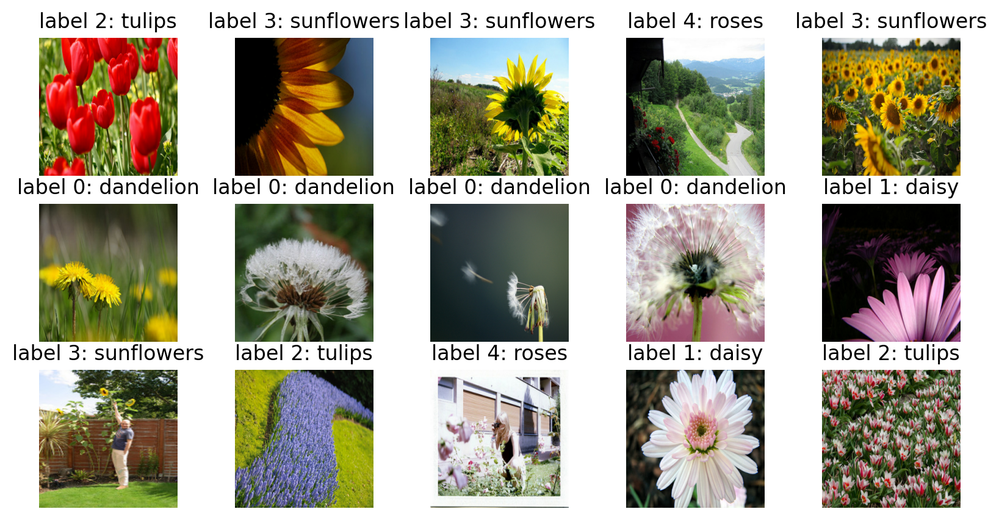

In [ ]:
plt.figure(figsize=(10, 5))


get_label_name = metadata.features['label'].int2str

for idx, (image, label) in enumerate(train.take(15)):
    plt.subplot(3, 5, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

In [ ]:
IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)

# Create the base model from the pre-trained model VGG16
base_model = tf.keras.applications.VGG16(input_shape=IMG_SHAPE,
                                         include_top=False,
                                         weights='imagenet')

In [ ]:
BATCH_SIZE = 32
SHUFFLE_BUFFER_SIZE = 1000

In [ ]:
train_batches = train.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE)
validation_batches = validation.batch(BATCH_SIZE)
test_batches = test.batch(BATCH_SIZE)

In [ ]:
for image_batch, label_batch in train_batches.take(1):
    break

image_batch.shape, label_batch.shape

(TensorShape([32, 299, 299, 3]), TensorShape([32]))

In [ ]:
image_batch.shape

TensorShape([32, 299, 299, 3])

In [ ]:
feature_batch = base_model(image_batch)
feature_batch.shape

TensorShape([32, 9, 9, 512])

In [ ]:
base_model.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 299, 299, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 299, 299, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 299, 299, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 149, 149, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 149, 149, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 149, 149, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 74, 74, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 74, 74, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 74, 74, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 74, 74, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 37, 37, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 37, 37, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 37, 37, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 37, 37, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 18, 18, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 18, 18, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 18, 18, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 18, 18, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 9, 9, 512)           │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()

In [ ]:
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 512)


In [ ]:
# dense layer에는 unit과 activation 2개의 매개변수만 사용해주세요.
# unit의 값은 위에서 global_average_layer를 통과했을 때의 값을 생각해보세요.
# 활성화 함수는 ReLU를 사용합니다.
dense_layer = tf.keras.layers.Dense(units=512, activation='relu')
# unit은 우리가 분류하고 싶은 class를 생각해보세요.
# 활성화 함수는 Softmax를 사용합니다.
prediction_layer = tf.keras.layers.Dense(units=512, activation='softmax')

# feature_batch_averag가 dense_layer를 거친 결과가 다시 prediction_layer를 거치게 되면
prediction_batch = prediction_layer(dense_layer(feature_batch_average))
print(prediction_batch.shape)

(32, 512)


In [ ]:
base_model.trainable = False

In [ ]:
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  dense_layer,
  prediction_layer
])

# 모델 요약
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ vgg16 (Functional)                   │ (None, 9, 9, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_3           │ (None, 512)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_13 (Dense)                     │ (32, 512)                   │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_14 (Dense)                     │ (32, 512)                   │         262,656 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 15,240,000 (58.14 MB)

 Trainable params: 525,312 (2.00 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [ ]:
learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
              loss=tf.keras.losses.sparse_categorical_crossentropy,
              metrics=['accuracy'])

In [ ]:
validation_steps=20
loss0, accuracy0 = model.evaluate(validation_batches, steps = validation_steps)

print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

20/20 ━━━━━━━━━━━━━━━━━━━━ 45s 904ms/step - accuracy: 0.0000e+00 - loss: 6.4311
initial loss: 6.43
initial accuracy: 0.00


/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


In [ ]:
EPOCHS = 10
history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

Epoch 1/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 47s 485ms/step - accuracy: 0.1872 - loss: 4.8893 - val_accuracy: 0.4523 - val_loss: 1.7926
Epoch 2/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.5350 - loss: 1.5524 - val_accuracy: 0.7030 - val_loss: 1.1910
Epoch 3/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.6869 - loss: 1.1384 - val_accuracy: 0.7221 - val_loss: 0.9898
Epoch 4/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 26s 275ms/step - accuracy: 0.7285 - loss: 0.9707 - val_accuracy: 0.7193 - val_loss: 0.8912
Epoch 5/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 26s 277ms/step - accuracy: 0.7357 - loss: 0.8743 - val_accuracy: 0.7520 - val_loss: 0.7924
Epoch 6/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.7671 - loss: 0.7699 - val_accuracy: 0.7602 - val_loss: 0.7368
Epoch 7/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 25s 273ms/step - accuracy: 0.7754 - loss: 0.7254 - val_accuracy: 0.7738 - val_loss: 0.6889
Epoch 8/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 26s 274ms/step - accuracy: 0.7809 - loss: 0.6900 - val_accu

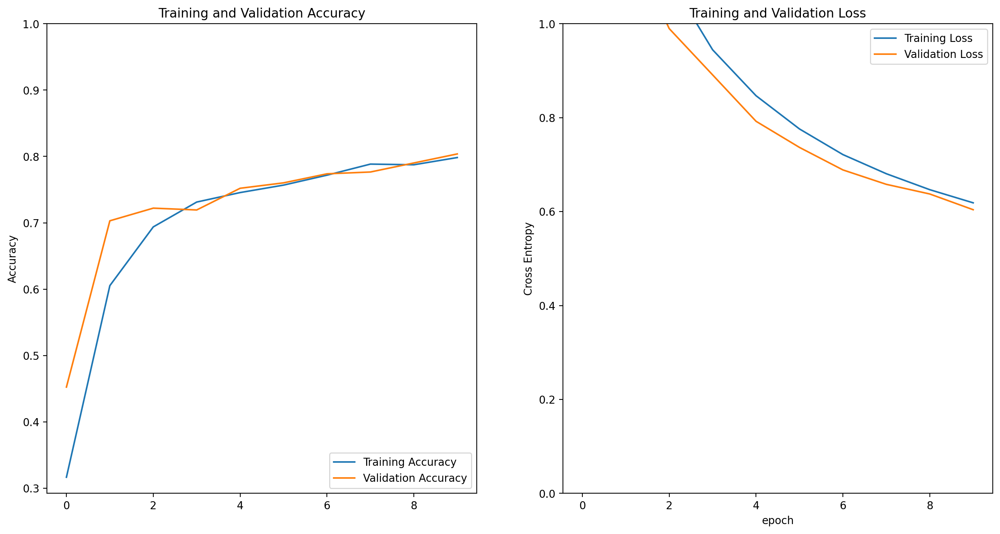

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(16, 8))
plt.subplot(1, 2, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [ ]:
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    pass

predictions

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


array([[1.4976588e-02, 9.0430617e-02, 5.9091341e-01, ..., 1.5174976e-06,
        4.0734735e-06, 2.2949396e-06],
       [9.8663634e-01, 8.1788469e-03, 7.1531528e-04, ..., 2.0472227e-07,
        1.9070988e-07, 2.1059911e-07],
       [8.3417165e-01, 7.6069079e-02, 2.2066070e-02, ..., 9.4383051e-07,
        1.3588774e-06, 1.1620700e-06],
       ...,
       [2.6004095e-02, 4.6214085e-02, 8.3575882e-02, ..., 1.7933669e-06,
        3.2114210e-06, 2.0643731e-06],
       [9.7926408e-01, 1.2058520e-02, 4.3057362e-03, ..., 3.2695391e-07,
        3.7157892e-07, 3.8092466e-07],
       [1.1965131e-02, 4.6060741e-02, 7.5109348e-02, ..., 3.7104758e-07,
        7.7613191e-07, 4.3923990e-07]], dtype=float32)

In [ ]:
import numpy as np
predictions = np.argmax(predictions, axis=1)
predictions

array([2, 0, 0, 2, 0, 0, 2, 1, 3, 0, 0, 1, 2, 4, 0, 3, 2, 1, 2, 2, 2, 0,
       1, 0, 1, 4, 2, 4, 2, 3, 0, 4])

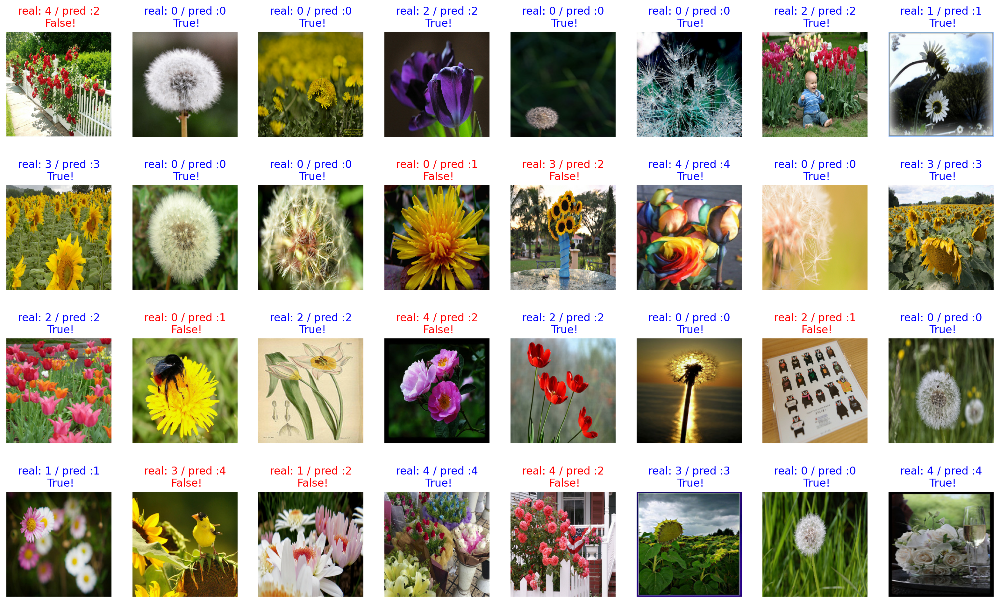

In [ ]:
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred :{prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

In [ ]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 32 * 100) # 약 95% 내외

71.875


# 2. Xception 모델

In [ ]:
import os, re  # 운영 체제와 상호 작용하는 기능을 제공합니다.
import numpy as np  # 과학 계산을 위한 라이브러리로, 주로 배열 및 행렬 연산에 사용됩니다.
import tensorflow as tf  # 머신러닝과 딥러닝을 위한 라이브러리입니다.
from tensorflow.keras.applications import Xception  # 사전 학습된 Xception 모델을 가져옵니다.
from tensorflow.keras.models import Model, load_model  # 모델을 생성하고 로드하는 기능을 제공합니다.
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, BatchNormalization, Dropout  # 모델의 층을 정의하는 데 사용됩니다.
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array  # 이미지 전처리 및 증강을 위한 도구입니다.
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint  # 학습 중 조기 종료 및 학습률 감소를 위한 콜백을 제공합니다.
from sklearn.model_selection import train_test_split  # 데이터를 학습용과 검증용으로 나누는 데 사용됩니다.
import matplotlib.pyplot as plt  # 그래프를 그리는 라이브러리입니다.

# 모델을 정의하는 함수입니다.
def create_model(class_names):
    # 사전 학습된 Xception 모델을 불러옵니다. (최상위 분류 층은 포함하지 않음)
    base_model = Xception(weights='imagenet', include_top=False, input_shape=(299, 299, 3))
    x = base_model.output  # Xception 모델의 출력값을 가져옵니다.
    x = GlobalAveragePooling2D()(x)  # 글로벌 평균 풀링 층을 추가합니다.
    x = Dense(2048, activation='relu')(x)  # 2048개의 뉴런을 가진 Dense 층을 추가하고, ReLU 활성화 함수를 사용합니다.
    x = BatchNormalization()(x)  # 배치 정규화를 추가합니다.
    x = Dropout(0.5)(x)  # 드롭아웃 층을 추가하여 50%의 뉴런을 무작위로 비활성화합니다.
    x = Dense(1024, activation='relu')(x)  # 1024개의 뉴런을 가진 Dense 층을 추가하고, ReLU 활성화 함수를 사용합니다.
    x = BatchNormalization()(x)  # 배치 정규화를 추가합니다.
    x = Dropout(0.5)(x)  # 드롭아웃 층을 추가하여 50%의 뉴런을 무작위로 비활성화합니다.
    x = Dense(512, activation='relu')(x)  # 512개의 뉴런을 가진 Dense 층을 추가하고, ReLU 활성화 함수를 사용합니다.
    x = BatchNormalization()(x)  # 배치 정규화를 추가합니다.
    x = Dropout(0.5)(x)  # 드롭아웃 층을 추가하여 50%의 뉴런을 무작위로 비활성화합니다.
    x = Dense(256, activation='relu')(x)  # 256개의 뉴런을 가진 Dense 층을 추가하고, ReLU 활성화 함수를 사용합니다.
    x = BatchNormalization()(x)  # 배치 정규화를 추가합니다.
    x = Dropout(0.5)(x)  # 드롭아웃 층을 추가하여 50%의 뉴런을 무작위로 비활성화합니다.
    predictions = Dense(num_classes, activation='softmax')(x)  # 최종 출력 층으로 num_classes개의 뉴런을 가진 Dense 층을 추가하고, 소프트맥스 활성화 함수를 사용합니다.

    model = Model(inputs=base_model.input, outputs=predictions)  # 입력과 출력을 지정하여 모델을 생성합니다.

        # 사전 학습된 모델의 상위 레이어를 고정합니다.
    for layer in base_model.layers[:100]:  # 첫 100개 레이어는 고정합니다.
        layer.trainable = False
    for layer in base_model.layers[100:]:  # 나머지 레이어는 학습 가능하게 설정합니다.
        layer.trainable = True

    return model

In [ ]:
# 모델을 생성합니다.
model_2 = create_model(class_names) # 5개


In [ ]:
model_2.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_11            │ (None, 299, 299, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv1 (Conv2D)     │ (None, 149, 149, 32)   │            864 │ input_layer_11[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv1_bn           │ (None, 149, 149, 32)   │            128 │ block1_conv1[0][0]     │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv1_act          │ (None, 149, 149, 32)   │              0 │ block1_conv1_bn[0][0]  │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv2 (Conv2D)     │ (None, 147, 147, 64)   │         18,432 │ block1_conv1_act[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv2_bn           │ (None, 147, 147, 64)   │            256 │ block1_conv2[0][0]     │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv2_act          │ (None, 147, 147, 64)   │              0 │ block1_conv2_bn[0][0]  │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_sepconv1           │ (None, 147, 147, 128)  │          8,768 │ block1_conv2_act[0][0] │
│ (SeparableConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_sepconv1_bn        │ (None, 147, 147, 128)  │            512 │ block2_sepconv1[0][0]  │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_sepconv2_act       │ (None, 147, 147, 128)  │              0 │ block2_sepconv1_bn[0]… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_sepconv2           │ (None, 147, 147, 128)  │         17,536 │ block2_sepconv2_act[0… │
│ (SeparableConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_sepconv2_bn        │ (None, 147, 147, 128)  │            512 │ block2_sepconv2[0][0]  │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_40 (Conv2D)        │ (None, 74, 74, 128)    │          8,192 │ block1_conv2_act[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_pool               │ (None, 74, 74, 128)    │              0 │ block2_sepconv2_bn[0]… │
│ (MaxPooling2D)            │                        │                │                        │
├──────────────────────

 Total params: 27,828,781 (106.16 MB)

 Trainable params: 16,437,965 (62.71 MB)

 Non-trainable params: 11,390,816 (43.45 MB)

In [ ]:
# 모델을 컴파일합니다.
model_2.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),  # Adam 옵티마이저를 사용하며 학습률을 설정합니다.
              loss='sparse_categorical_crossentropy',  # 다중 클래스 분류를 위해 sparse_categorical_crossentropy 손실 함수를 사용합니다.
              metrics=['accuracy'])  # 정확도를 평가 지표로 설정합니다.

In [ ]:
EPOCHS = 10
history_2 = model_2.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

Epoch 1/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 116s 804ms/step - accuracy: 0.3220 - loss: 2.2385 - val_accuracy: 0.6975 - val_loss: 1.1593
Epoch 2/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 34s 364ms/step - accuracy: 0.6463 - loss: 1.0334 - val_accuracy: 0.8692 - val_loss: 0.6408
Epoch 3/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 32s 348ms/step - accuracy: 0.7810 - loss: 0.6235 - val_accuracy: 0.8992 - val_loss: 0.3697
Epoch 4/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 33s 351ms/step - accuracy: 0.8421 - loss: 0.4627 - val_accuracy: 0.9210 - val_loss: 0.2476
Epoch 5/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 33s 353ms/step - accuracy: 0.8571 - loss: 0.3910 - val_accuracy: 0.9210 - val_loss: 0.2268
Epoch 6/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 32s 350ms/step - accuracy: 0.8922 - loss: 0.3031 - val_accuracy: 0.9401 - val_loss: 0.2159
Epoch 7/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 32s 350ms/step - accuracy: 0.9155 - loss: 0.2422 - val_accuracy: 0.9346 - val_loss: 0.2075
Epoch 8/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 33s 351ms/step - accuracy: 0.9283 - loss: 0.2097 - val_acc

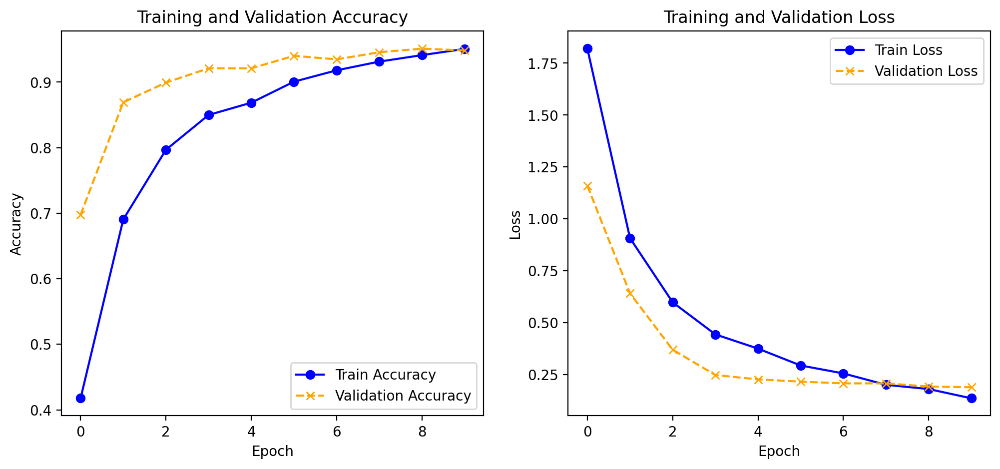

In [ ]:
# 훈련 결과를 시각화합니다.
def plot_history(history_2):
    plt.figure(figsize=(12, 5))

    # 정확도 플롯
    plt.subplot(1, 2, 1)
    plt.plot(history_2.history['accuracy'], label='Train Accuracy', color='blue', linestyle='-', marker='o')
    plt.plot(history_2.history['val_accuracy'], label='Validation Accuracy', color='orange', linestyle='--', marker='x')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    # 손실 플롯
    plt.subplot(1, 2, 2)
    plt.plot(history_2.history['loss'], label='Train Loss', color='blue', linestyle='-', marker='o')
    plt.plot(history_2.history['val_loss'], label='Validation Loss', color='orange', linestyle='--', marker='x')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.show()

plot_history(history_2)

In [ ]:
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions_2 = model_2.predict(image_batch)
    pass

predictions_2

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


array([[5.55252563e-03, 1.32832201e-02, 5.01581132e-01, 8.09828471e-03,
        4.71484929e-01],
       [9.99628544e-01, 2.87881587e-04, 1.50918440e-05, 1.09443099e-05,
        5.73863726e-05],
       [2.65833318e-01, 3.91456112e-03, 1.16598355e-02, 7.13479817e-01,
        5.11237839e-03],
       [4.64943296e-05, 1.25123290e-04, 9.95910287e-01, 2.15071359e-05,
        3.89655516e-03],
       [9.99841928e-01, 1.20195982e-04, 1.54188751e-06, 1.23053560e-05,
        2.41144407e-05],
       [9.99955297e-01, 2.99007443e-05, 4.20437118e-06, 1.85038812e-06,
        8.67949166e-06],
       [5.93248697e-05, 1.30412387e-04, 9.99749243e-01, 2.71265562e-05,
        3.38650170e-05],
       [1.05779531e-04, 9.91227090e-01, 2.29262023e-05, 8.47457349e-03,
        1.69664432e-04],
       [1.56710271e-07, 4.44968975e-07, 5.77685205e-05, 9.99940872e-01,
        6.76689240e-07],
       [9.98040617e-01, 1.34424865e-03, 6.53960669e-05, 1.15922317e-04,
        4.33802576e-04],
       [9.99815285e-01, 1.5949

In [ ]:
import numpy as np
predictions_2 = np.argmax(predictions_2, axis=1)
predictions_2

array([2, 0, 3, 2, 0, 0, 2, 1, 3, 0, 0, 0, 3, 4, 0, 3, 2, 0, 2, 4, 2, 0,
       4, 0, 1, 4, 1, 4, 4, 3, 0, 4])

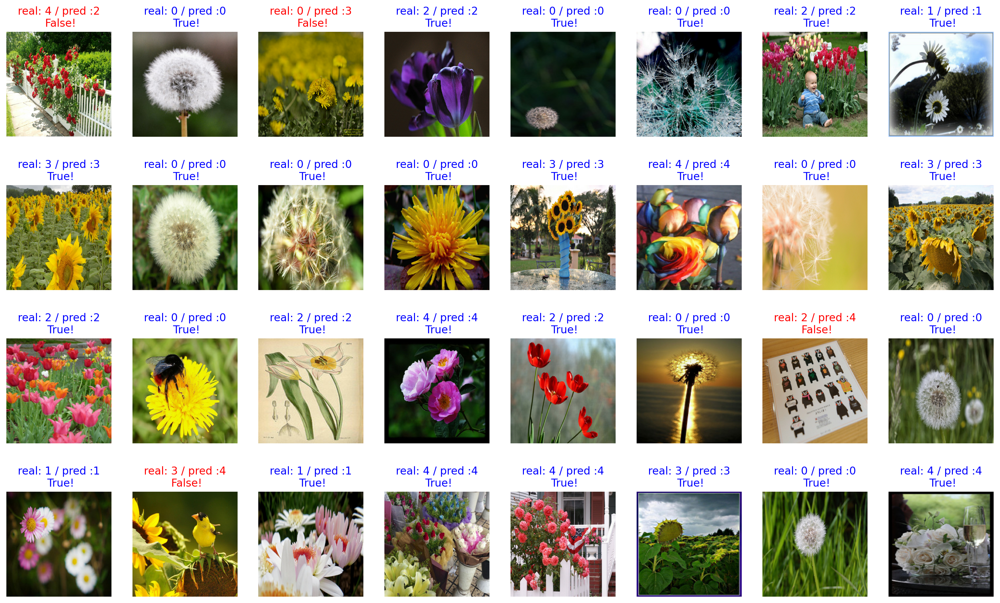

In [ ]:
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions_2)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    correct_2 = label == prediction
    title = f'real: {label} / pred :{prediction}\n {correct_2}!'
    if not correct_2:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

In [ ]:
count = 0
for image, label, prediction in zip(images, labels, predictions_2):
    correct_2 = label == prediction
    if correct_2:
        count = count + 1

print(count / 32 * 100)

87.5


In [ ]:
model_2.save('xception_flower.keras')